In [1]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
from IPython.display import Audio, display, Image, YouTubeVideo

In [257]:
from os import listdir
from os.path import isfile, join
import re
filenames = [f for f in listdir('./sounds') if isfile(join('./sounds', f))][1:]
print(filenames)
bpm_list = [entry[re.search("[0-9]+", entry).span()[0]: re.search("[0-9]+", entry).span()[1]] for entry in filenames]
#print(l)
l = []
#print(new_list[0])
for i, file in enumerate(filenames):
    print(i)
    print(file)
    l.append([file, bpm_list[i]])

    #print(file)
    #res = re.subgroup(file, 'bpm$')
print(l)
    #print(res)

['140bpm-gassin.mp3', '000bpm_Snariga Dungen.mp3', '150bpm-gym-song.mp3', '120bpm-get-your-girls.mp3', '175bpm-dreams.mp3', '92bpm_hiphop10secloop.wav', '149bpm-full-female-rap-kmrs.mp3', '89bpm-angel-of-music.mp3', '000bpm_Annabelle v1.3.wav']
0
140bpm-gassin.mp3
1
000bpm_Snariga Dungen.mp3
2
150bpm-gym-song.mp3
3
120bpm-get-your-girls.mp3
4
175bpm-dreams.mp3
5
92bpm_hiphop10secloop.wav
6
149bpm-full-female-rap-kmrs.mp3
7
89bpm-angel-of-music.mp3
8
000bpm_Annabelle v1.3.wav
[['140bpm-gassin.mp3', '140'], ['000bpm_Snariga Dungen.mp3', '000'], ['150bpm-gym-song.mp3', '150'], ['120bpm-get-your-girls.mp3', '120'], ['175bpm-dreams.mp3', '175'], ['92bpm_hiphop10secloop.wav', '92'], ['149bpm-full-female-rap-kmrs.mp3', '149'], ['89bpm-angel-of-music.mp3', '89'], ['000bpm_Annabelle v1.3.wav', '000']]


In [258]:
print(filenames)

['140bpm-gassin.mp3', '000bpm_Snariga Dungen.mp3', '150bpm-gym-song.mp3', '120bpm-get-your-girls.mp3', '175bpm-dreams.mp3', '92bpm_hiphop10secloop.wav', '149bpm-full-female-rap-kmrs.mp3', '89bpm-angel-of-music.mp3', '000bpm_Annabelle v1.3.wav']


sounds/140bpm-gassin.mp3


/Users/leozethraeus/opt/anaconda3/envs/beat/lib/python3.8/site-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


length of song: 27.5 seconds


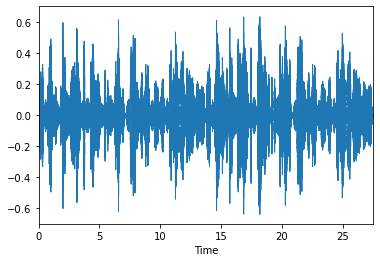

In [346]:
#filename = 'sounds/92bpm_hiphop10secloop.wav'
songId = 0
filename= 'sounds/'+l[songId][0]
print(filename)
y, sr = librosa.load(filename)
# trim silent edges
song, _ = librosa.effects.trim(y)
length = librosa.get_duration(song)
print(f'length of song: {length:.1f} seconds')
y_harmonic, song = librosa.effects.hpss(song) #FT first??
librosa.display.waveplot(song, sr=sr);
n_fft = 2048
D = np.abs(librosa.stft(song[:n_fft], n_fft=n_fft, hop_length=n_fft+1))


In [347]:
n_mels = 128
mel = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=n_mels)


onset_env = librosa.onset.onset_strength(song, sr=sr)

static_tempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr)[0]
#static_tempo = librosa.beat.tempo(y,sr=sr, start_bpm=120, std_bpm = 100)[0]
#print(static_tempo)

dynamic_tempo, beats = librosa.beat.beat_track(y=song, sr=sr)
beats_in_t = librosa.frames_to_time(beats, sr=sr)
#print(beats_in_t)
#print(dynamic_tempo)
actual_tempo = l[songId][-1]
diff = min(abs(int(dynamic_tempo)-int(actual_tempo)), abs(int(static_tempo)-int(actual_tempo)))
#print(diff)
song_name = l[songId][0]
length = librosa.get_duration(song)
print("""Estimated tempo (dynamic) {0:.1f} BPM, \nEstimated tempo (static): {1:.1f} BPM, \n
Real tempo: {2} BPM. \nMinimum difference {3} BPM \nIn song {4} of length {5:.1f} seconds""".format(dynamic_tempo, static_tempo, actual_tempo, diff, song_name, length))
    


Estimated tempo (dynamic) 136.0 BPM, 
Estimated tempo (static): 136.0 BPM, 

Real tempo: 140 BPM. 
Minimum difference 5 BPM 
In song 140bpm-gassin.mp3 of length 27.5 seconds


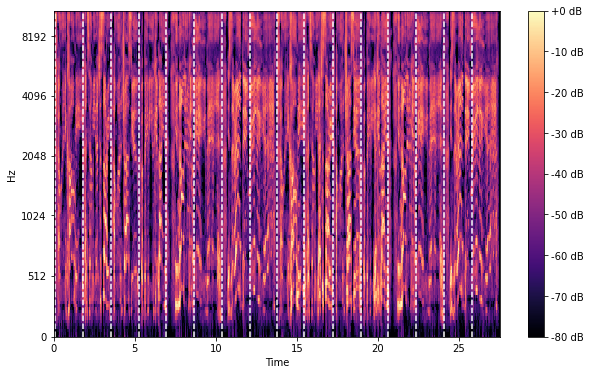

In [348]:
hop_length = 512
S = librosa.feature.melspectrogram(song, sr=sr, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
S_DB = librosa.power_to_db(S, ref=np.max)


#Display Mel-spectogram with white vertical lines to mark the beats
fig = plt.figure(figsize=(10, 6));
librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, x_axis='time', y_axis='mel');
plt.colorbar(format='%+2.0f dB');
for xc in beats_in_t[::4]:
    plt.axvline(x=xc, color = "white", linestyle="--")

#Listen to the track with clicks on the beats
y_beat_times = librosa.clicks(frames=beats, sr=sr, length=len(song))
y_new = y_harmonic+song+y_beat_times
Audio(data=y_new, rate=sr)

In [177]:
Audio(data=y, rate=sr)

In [128]:
y_tritone = librosa.effects.pitch_shift(y, sr, n_steps=3)
Audio(data=y_tritone, rate=sr)

In [360]:
#Speed it up
speed_factor = 1.7
y_speed = librosa.effects.time_stretch(y_new, speed_factor)
Audio(data=y_speed, rate=sr)


In [270]:


onset_env = librosa.onset.onset_strength(y, sr=sr)

tempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr)
print(tempo)

[117.45383523]


In [349]:
#y, sr = librosa.load(librosa.ex('trumpet'))

f0, voiced_flag, voiced_probs = librosa.pyin(y_harmonic+song, fmin=librosa.note_to_hz('C2'), fmax=librosa.note_to_hz('C7'))

times = librosa.times_like(f0)

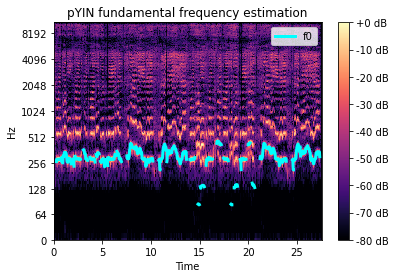

In [350]:
D = librosa.amplitude_to_db(np.abs(librosa.stft(y_harmonic)), ref=np.max)

fig, ax = plt.subplots()

img = librosa.display.specshow(D, x_axis='time', y_axis='log', ax=ax)

ax.set(title='pYIN fundamental frequency estimation')

fig.colorbar(img, ax=ax, format="%+2.f dB")

ax.plot(times, f0, label='f0', color='cyan', linewidth=3)

ax.legend(loc='upper right')



In [351]:
f_clean = f0[~np.isnan(f0)]
f_median = np.median(f_clean)
print(f_clean[:5])
print(f_median)
print(librosa.hz_to_note(f_median))
tone = librosa.tone(f_median, length=len(y_new))
y_n = y_new+tone
Audio(data=y_n, rate=sr)

[264.66550794 282.02769802 283.66146786 282.02769802 275.5861765 ]
286.9574553484241
D4


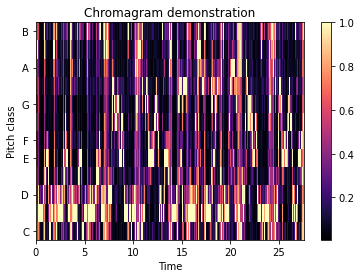

In [352]:
chroma = librosa.feature.chroma_cqt(y=song+y_harmonic, sr=sr)

fig, ax = plt.subplots()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax)
ax.set(title='Chromagram demonstration')
fig.colorbar(img, ax=ax)


In [353]:
print(chroma.shape)
d = {0 : "C", 1: "C#", 2: "D", 3: "D#", 4: "E", 5: "F", 6: "F#", 7: "G", 8: "G#", 9: "A", 10: "A#", 11: "B"}
key = np.argmax(np.mean(chroma, axis=1))

#print(key_ind)
included_notes = [d.get(ind) for ind in list(np.where(np.mean(chroma, axis=1) > np.mean(np.mean(chroma, axis=1)))[0])]
#print(included_notes)
print(d.get(key))
norm = np.array([(d.get(i),np.mean(chroma, axis=1)[i]) for i in range(12)])#[(d.get(np.argslrt())) for enumeratenp.mean(chroma, axis=1)
#print(norm)
#print(i)
key_ind = np.argsort(np.mean(chroma, axis=1))
#print(key_ind)
print(norm[key_ind][::-1])
#print(np.sort(norm, axis=1))

(12, 1186)
C#
[['C#' '0.5702483']
 ['D' '0.43510655']
 ['C' '0.34140956']
 ['E' '0.3366476']
 ['B' '0.3150491']
 ['G#' '0.30454558']
 ['D#' '0.28642806']
 ['A' '0.27595586']
 ['G' '0.26938966']
 ['A#' '0.26355988']
 ['F' '0.26039806']
 ['F#' '0.25930157']]
